<a href="https://colab.research.google.com/github/soti994/My_MSc_thesis/blob/main/LSTM_colab_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Libraries and mounting



In [ ]:
import numpy as np
import tensorflow as tf
import random as rn
import os
#os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
#os.environ["CUDA_VISIBLE_DEVICES"] = ""
os.environ['PYTHONHASHSEED'] = '0'
np.random.seed(42)
rn.seed(12345)
tf.random.set_seed(1234)
session_conf = tf.compat.v1.ConfigProto(
    intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)

from tensorflow import keras
from tensorflow.keras import backend as K
sess = tf.compat.v1.Session(
    graph=tf.compat.v1.get_default_graph(), config=session_conf)
tf.compat.v1.keras.backend.set_session(sess)

import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import nltk
import string
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Input, Embedding, LSTM, Bidirectional, BatchNormalization, SpatialDropout1D, GRU, GlobalAveragePooling1D, Dense, Dropout, concatenate
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.initializers import Constant
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model
import tensorflow_hub as hub
import logging
from IPython.display import display, HTML
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.utils import class_weight
from tensorflow.keras.utils import plot_model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from gensim.models import Word2Vec, FastText
logging.basicConfig(level=logging.INFO)
from sklearn.preprocessing import label_binarize
from itertools import cycle
from sklearn.metrics import roc_curve, auc
from scipy import interp
import tensorflow_hub as hub
import random 
import math
import seaborn as sns

In [ ]:
#Disabling auto-scroll of outputs

def set_css():
  display(HTML('''
  <style>
    pre {
        white-space: pre-wrap;
    }
  </style>
  '''))
get_ipython().events.register('pre_run_cell', set_css)

In [ ]:
import io
from google.colab import drive 
 
#Import Training data  
drive.mount("/content/drive") 

train = pd.read_csv('/content/drive/My Drive/thesis_sotiria/preprocessed_tweets_new.csv')
test = pd.read_csv('/content/drive/My Drive/thesis_sotiria/test_preprocessed_tweets_new.csv')



#TRAIN DATA
X = train.loc[:, 'Preprocessed_sentences'].values
y = train.loc[:, 'Sentiment'].values

#TEST DATA

X_test = test.loc[:, 'Preprocessed_sentences'].values
y_test = test.loc[:, 'Sentiment'].values

Mounted at /content/drive


#Bert+LSTM

In [ ]:
!pip install bert-for-tf2
from bert import bert_tokenization
module_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/2'
bert_layer = hub.KerasLayer(module_url, trainable=True)

In [ ]:
#Import Training/Test data  
'''
train_raw = pd.read_csv('/content/drive/My Drive/thesis_sotiria/Corona_NLP_train.csv'
, delimiter=',', encoding= 'ISO-8859-1')

test_raw = pd.read_csv('/content/drive/My Drive/thesis_sotiria/Corona_NLP_test.csv'
, delimiter=',', encoding= 'ISO-8859-1') '''

#train_raw = train.drop(['UserName','ScreenName', 'Location', 'TweetAt'], axis=1)
#test_raw = test.drop(['UserName','ScreenName', 'Location', 'TweetAt'], axis=1)
train_raw = train[['OriginalTweet', 'Sentiment']]
test_raw = test[['OriginalTweet', 'Sentiment']]

def change_values(string):
    if string == "Extremely Negative":
        return 0
    elif string == "Negative":
        return 0
    elif string == "Positive":
        return 2 
    elif string == "Extremely Positive":
        return 2
    elif string == "Neutral":
        return 1 
    
#train_raw['Sentiment'] = train_raw['Sentiment'].apply(change_values)
#test_raw['Sentiment'] = test_raw['Sentiment'].apply(change_values)

In [ ]:
vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()
tokenizer = bert_tokenization.FullTokenizer(vocab_file, do_lower_case)

def bert_encode(texts, tokenizer, max_len=512):
    all_tokens = []
    all_masks = []
    all_segments = []
    
    for text in texts:
        text = tokenizer.tokenize(text)
            
        text = text[:max_len-2]
        input_sequence = ["[CLS]"] + text + ["[SEP]"]
        pad_len = max_len - len(input_sequence)
        
        tokens = tokenizer.convert_tokens_to_ids(input_sequence) + [0] * pad_len
        pad_masks = [1] * len(input_sequence) + [0] * pad_len
        segment_ids = [0] * max_len
        
        all_tokens.append(tokens)
        all_masks.append(pad_masks)
        all_segments.append(segment_ids)
    
    return np.array(all_tokens), np.array(all_masks), np.array(all_segments)

In [ ]:
def build_model(max_len=512):
    embedding_size = 200
    input_word_ids = tf.keras.Input(shape=(max_len,), dtype=tf.int32, name="input_word_ids")
    input_mask = tf.keras.Input(shape=(max_len,), dtype=tf.int32, name="input_mask")
    segment_ids = tf.keras.Input(shape=(max_len,), dtype=tf.int32, name="segment_ids")

    pooled_output, sequence_output = bert_layer([input_word_ids, input_mask, segment_ids])
    net = tf.keras.layers.Bidirectional(LSTM(64, dropout=0.5))(sequence_output)
    net = tf.keras.layers.Dropout(0.2)(net)
    out = tf.keras.layers.Dense(3, activation='softmax')(net)

    model = tf.keras.models.Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=out)
    model.compile(tf.keras.optimizers.Adam(lr=1e-5), loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [ ]:
max_length = 180
print(max_length)
train_input_raw = bert_encode(train_raw.OriginalTweet.values, tokenizer, max_len=max_length)
test_input_raw = bert_encode(test_raw.OriginalTweet.values, tokenizer, max_len=max_length)
#train_input = bert_encode(train.Preprocessed_sentences.values, tokenizer, max_len=max_leng)
#test_input = bert_encode(test.Preprocessed_sentences.values, tokenizer, max_len=max_leng)
train_labels = tf.one_hot(train_raw.Sentiment.values, depth= 3)


180


In [ ]:
model = build_model(max_len=max_length)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_word_ids (InputLayer)     [(None, 180)]        0                                            
__________________________________________________________________________________________________
input_mask (InputLayer)         [(None, 180)]        0                                            
__________________________________________________________________________________________________
segment_ids (InputLayer)        [(None, 180)]        0                                            
__________________________________________________________________________________________________
keras_layer (KerasLayer)        [(None, 768), (None, 109482241   input_word_ids[0][0]             
                                                                 input_mask[0][0]             

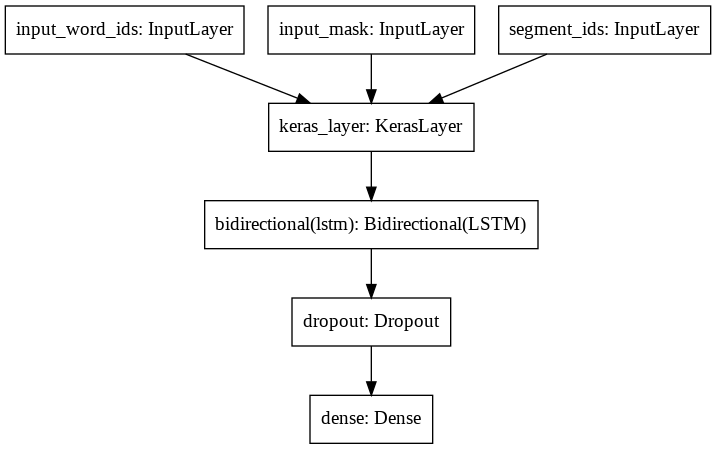

Epoch 1/4
1029/1029 [==============================] - 1379s 1s/step - loss: 0.8171 - accuracy: 0.6127 - val_loss: 0.4903 - val_accuracy: 0.8299

Epoch 00001: val_accuracy improved from -inf to 0.82993, saving model to bert_lstm.h5
Epoch 2/4
1029/1029 [==============================] - 1364s 1s/step - loss: 0.3980 - accuracy: 0.8598 - val_loss: 0.3674 - val_accuracy: 0.8859

Epoch 00002: val_accuracy improved from 0.82993 to 0.88593, saving model to bert_lstm.h5
Epoch 3/4
1029/1029 [==============================] - 1363s 1s/step - loss: 0.2829 - accuracy: 0.9071 - val_loss: 0.2858 - val_accuracy: 0.9153

Epoch 00003: val_accuracy improved from 0.88593 to 0.91533, saving model to bert_lstm.h5
Epoch 4/4
1029/1029 [==============================] - 1363s 1s/step - loss: 0.2191 - accuracy: 0.9287 - val_loss: 0.2768 - val_accuracy: 0.9146

Epoch 00004: val_accuracy did not improve from 0.91533


In [ ]:

K.clear_session()
# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/bert_lstm.png"))

checkpoint = tf.keras.callbacks.ModelCheckpoint('bert_lstm.h5', 
                        monitor='val_accuracy', save_best_only=True, verbose=2)
earlystopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5, verbose=2)

train_labels_class_weights = np.argmax(train_labels, axis =1)
class_weights = class_weight.compute_class_weight(
    'balanced', 
    np.unique(train_labels_class_weights), train_labels_class_weights)
class_weight_dict = dict(enumerate(class_weights))

train_history = model.fit(
    train_input_raw, train_labels, 
    validation_split=0.2,
    epochs=4,
    callbacks=[checkpoint, earlystopping],
    batch_size=32,
    class_weight=class_weight_dict, shuffle=False,
    verbose=1)


              precision    recall  f1-score   support

           0       0.90      0.93      0.91      1633
           1       0.85      0.84      0.85       619
           2       0.92      0.88      0.90      1546

    accuracy                           0.90      3798
   macro avg       0.89      0.89      0.89      3798
weighted avg       0.90      0.90      0.90      3798



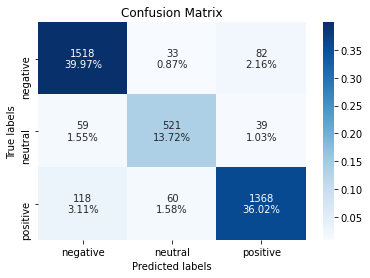

In [ ]:
model = keras.models.load_model('bert_lstm.h5', custom_objects={'KerasLayer': bert_layer})
test_labels = test['Sentiment'].to_numpy()
test_pred_raw = np.argmax(model.predict(test_input_raw), axis=-1)

confusion_mat = confusion_matrix(test_labels, test_pred_raw )
classification_rep = classification_report(test_labels, test_pred_raw)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/bert_lstm_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


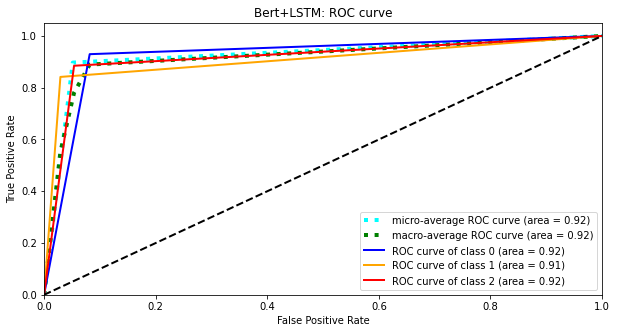

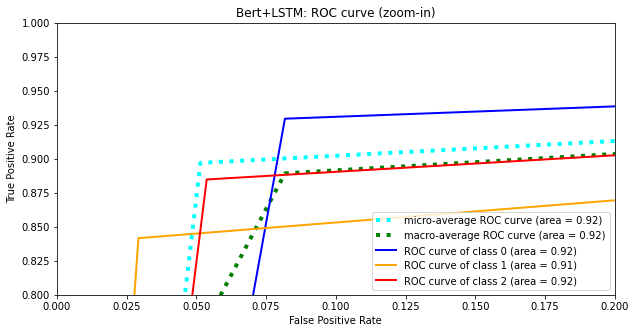

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(test_pred_raw , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Bert+LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bert_lstm_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0, 0.2)
plt.ylim(0.8, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Bert+LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bert_lstm_roc_zoom.png')
plt.show()

#Bert_tokenizer

In [ ]:
# Bert
!pip install bert-for-tf2
!pip install sentencepiece

try:
    %tensorflow_version 2.x
except Exception:
    pass
import tensorflow as tf



from tensorflow.keras import layers
import bert

BertTokenizer = bert.bert_tokenization.FullTokenizer
bert_layer = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1",
                            trainable=False)
vocabulary_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
to_lower_case = bert_layer.resolved_object.do_lower_case.numpy()
tokenizer = BertTokenizer(vocabulary_file, to_lower_case)

     |████████████████████████████████| 51kB 7.6MB/s 
  Created wheel for bert-for-tf2: filename=bert_for_tf2-0.14.9-cp37-none-any.whl size=30535 sha256=dabdaebed5b842b4f18efd7e25bf01179672e2ca0e839e3754bc8d5d4c2f76d2
  Stored in directory: /root/.cache/pip/wheels/a1/04/ee/347bd9f5b821b637c76411d280271a857aece00358896a230f
  Created wheel for py-params: filename=py_params-0.10.2-cp37-none-any.whl size=7912 sha256=14ee3be76104b0cb0f8f32d042fb94bf8c676086aae5d558431ce5ceaddea4ec
  Stored in directory: /root/.cache/pip/wheels/d0/4a/70/ff12450229ff1955abf01f365051d4faae1c20aef53ab4cf09
  Created wheel for params-flow: filename=params_flow-0.8.2-cp37-none-any.whl size=19472 sha256=f1843c62dc987f2e13c6150a4dcc37f7d96ac464d3e713f9bdaf1a248dee5b94
  Stored in directory: /root/.cache/pip/wheels/08/c8/7f/81c86b9ff2b86e2c477e3914175be03e679e596067dc630c06
Successfully built bert-for-tf2 py-params params-flow
     |████████████████████████████████| 1.2MB 15.0MB/s 


INFO:absl:Using /tmp/tfhub_modules to cache modules.
INFO:absl:Downloading TF-Hub Module 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1'.
INFO:absl:Downloaded https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1, Total size: 423.26MB
INFO:absl:Downloaded TF-Hub Module 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1'.


Building model...
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Bert_tokenizer (Embedding)   (None, 250, 200)          6104400   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 250, 200)          0         
_________________________________________________________________
bidirectional (Bidirectional (None, 128)               135680    
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 3)                 387       
Total params: 6,240,467
Trainable params: 6,240,467
Non-trainable params: 0
_________________________________________________________________
None


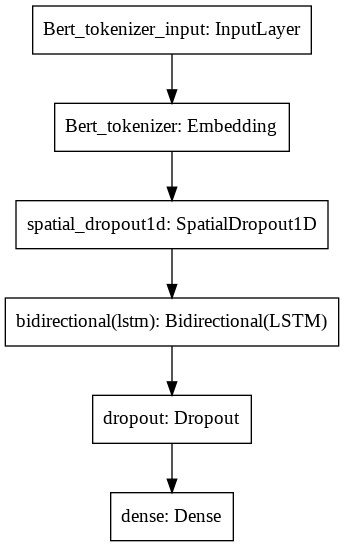

Train...
{0: 0.8932204769268333, 1: 1.7793450064850842, 2: 0.7584657912923289}
Epoch 1/100
1029/1029 [==============================] - 124s 88ms/step - loss: 0.8983 - accuracy: 0.5517 - val_loss: 0.5365 - val_accuracy: 0.8093

Epoch 00001: val_accuracy improved from -inf to 0.80928, saving model to bert_tok_lstm.h5
Epoch 2/100
1029/1029 [==============================] - 89s 87ms/step - loss: 0.4864 - accuracy: 0.8311 - val_loss: 0.4793 - val_accuracy: 0.8358

Epoch 00002: val_accuracy improved from 0.80928 to 0.83576, saving model to bert_tok_lstm.h5
Epoch 3/100
1029/1029 [==============================] - 88s 86ms/step - loss: 0.3835 - accuracy: 0.8717 - val_loss: 0.4633 - val_accuracy: 0.8417

Epoch 00003: val_accuracy improved from 0.83576 to 0.84172, saving model to bert_tok_lstm.h5
Epoch 4/100
1029/1029 [==============================] - 88s 86ms/step - loss: 0.3395 - accuracy: 0.8869 - val_loss: 0.4734 - val_accuracy: 0.8417

Epoch 00004: val_accuracy did not improve from 0.841

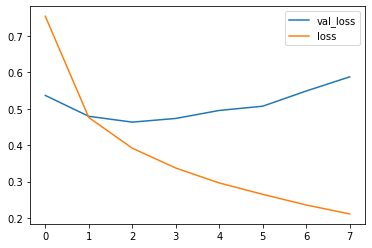

In [ ]:
#Bert

#Train-validation data split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, random_state=101)

depth= 3
y_one= tf.one_hot(y_train, depth)
y_train= tf.one_hot(y_train, depth)
y_val= tf.one_hot(y_val, depth)

def tokenize_reviews(text_reviews):
    return tokenizer.convert_tokens_to_ids(
        tokenizer.tokenize(text_reviews))

#pad_sequences
columns = [train['OriginalTweet']]

text = pd.concat(columns)
max_length = 250

#define vocabulary size
vocab_size = len(tokenizer.vocab)


X_train_tokens = [tokenize_reviews(review) for review in X_train]

X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_val_tokens = [tokenize_reviews(review) for review in X_val]

X_val_pad = pad_sequences(X_val_tokens, 
                maxlen= max_length, padding= 'post')

#Build Model

embedding_dim = 200

print('Building model...')

model = Sequential()
model.add(Embedding(vocab_size, embedding_dim, input_length = max_length, 
                    name="Bert_tokenizer"))
#model.add(Embedding(embedding_layer))
model.add(SpatialDropout1D(0.25))
model.add(Bidirectional(LSTM(64, dropout=0.5)))
model.add(Dropout(0.2))
model.add(Dense(3, activation='softmax'))
model.compile(loss='categorical_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/bert_tok_lstm.png"))

#Training Model

print('Train...')
y_train_labels = np.argmax(y_one, axis =1)
class_weights = class_weight.compute_class_weight('balanced', 
                                                  np.unique(y_train_labels), y_train_labels)
class_weight_dict = dict(enumerate(class_weights))
print(class_weight_dict)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'bert_tok_lstm.h5', monitor='val_accuracy', save_best_only=True, verbose=2)
early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 5)
      
model.fit(X_train_pad, y_train, validation_data=(X_val_pad, y_val), 
          batch_size= 32, epochs= 100, class_weight= class_weight_dict,
          callbacks = [checkpoint, early_stop])

#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]
plt.savefig("/content/drive/My Drive/thesis_sotiria/bert_tok_lstm_losses.png")

              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1633
           1       0.77      0.77      0.77       619
           2       0.82      0.83      0.82      1546

    accuracy                           0.82      3798
   macro avg       0.81      0.81      0.81      3798
weighted avg       0.82      0.82      0.82      3798



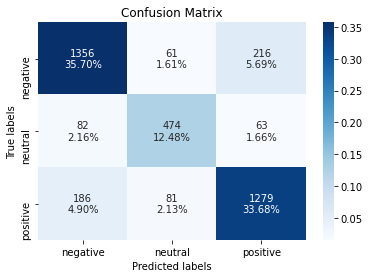

In [ ]:
X_test_tokens = [tokenize_reviews(review) for review in X_test]

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

model = keras.models.load_model('bert_tok_lstm.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict(X_test_pad), axis=-1)

confusion_mat = confusion_matrix(test_labels, y_pred)
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/bert_tok_lstm_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


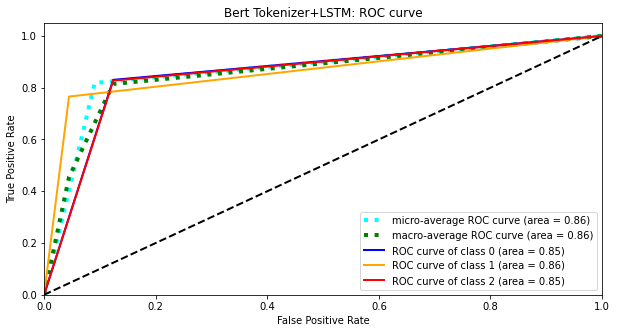

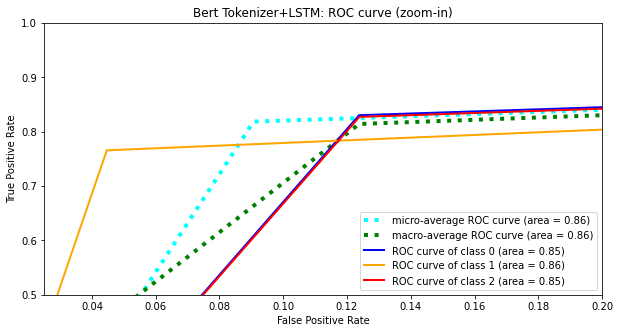

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Bert Tokenizer+LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bert_tok_lstm_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.2)
plt.ylim(0.5, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Bert Tokenizer+LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bert_tok_lstm_roc_zoom.png')
plt.show()

# Simple_LSTM

20857
throughout the last few week my wife have work instantly hard . work <number> + hr in a grocery store to keep up with covid <number> madness be imaginable . so much love and respect for her . show some respect to retail worker next opportunity you get . <hashtag> [1275, 3, 213, 282, 103, 43, 490, 14, 60, 4714, 307, 60, 6, 1344, 11, 10, 31, 21, 5, 95, 36, 30, 16, 6, 1792, 4, 5238, 59, 205, 483, 7, 864, 13, 255, 244, 86, 864, 5, 154, 62, 258, 710, 17, 41, 2]
Building model...
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 117, 200)          4171400   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 117, 200)          0         
_________________________________________________________________
lstm (LSTM)                  (None, 117, 180)          274320    
_________________________________

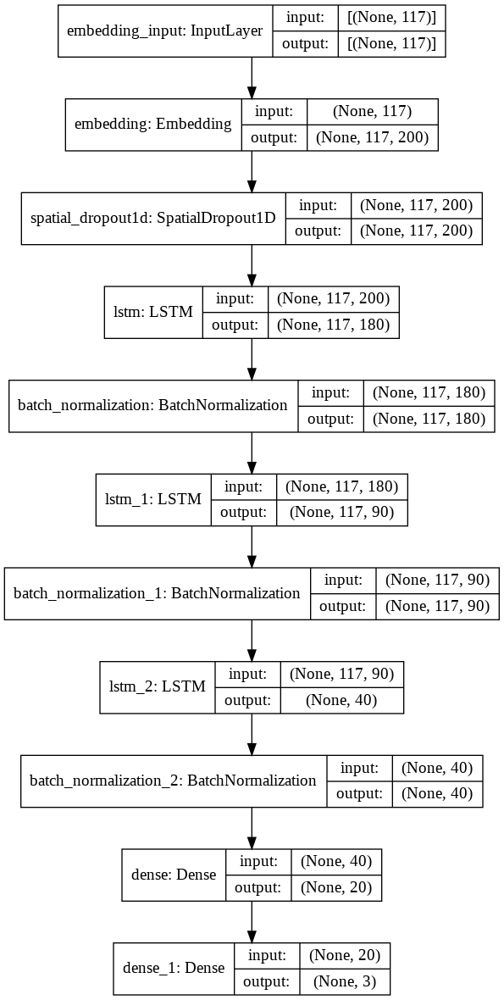

Train...
{0: 0.8909598649175218, 1: 1.778685336444963, 2: 0.7602238723262773}
Epoch 1/100
1029/1029 [==============================] - 76s 70ms/step - loss: 1.1280 - accuracy: 0.3473 - val_loss: 1.0474 - val_accuracy: 0.4108

Epoch 00001: val_accuracy improved from -inf to 0.41084, saving model to simple_lstm.h5
Epoch 2/100
1029/1029 [==============================] - 70s 68ms/step - loss: 1.0005 - accuracy: 0.4275 - val_loss: 1.0340 - val_accuracy: 0.4342

Epoch 00002: val_accuracy improved from 0.41084 to 0.43416, saving model to simple_lstm.h5
Epoch 3/100
1029/1029 [==============================] - 69s 67ms/step - loss: 0.8821 - accuracy: 0.4979 - val_loss: 1.0789 - val_accuracy: 0.4514

Epoch 00003: val_accuracy improved from 0.43416 to 0.45141, saving model to simple_lstm.h5
Epoch 4/100
1029/1029 [==============================] - 69s 67ms/step - loss: 0.8334 - accuracy: 0.5146 - val_loss: 0.9756 - val_accuracy: 0.4973

Epoch 00004: val_accuracy improved from 0.45141 to 0.49733, 

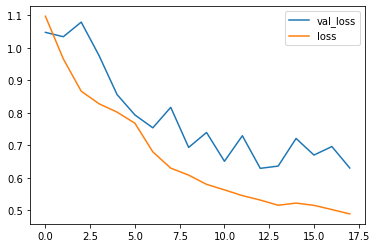

In [ ]:
#1
#Simple LSTM

#Train-test data split
#X_train_val, X_test, y_train, y_test = train_test_split(
#    X, y, test_size=0.2, random_state=101) 

#Train-validation data split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, random_state=101)

depth= 3
y_one= tf.one_hot(y, depth)
y_train= tf.one_hot(y_train, depth)
y_val= tf.one_hot(y_val, depth)


tokenizer = Tokenizer(oov_token = True)
tokenizer.fit_on_texts(X)

#pad_sequences
columns = [train['Preprocessed_sentences']]

text = pd.concat(columns)
max_length = max([len(s.split()) for s in text])

#define vocabulary size
vocab_size = len(tokenizer.word_index) + 1
print(vocab_size)

X_train_tokens = tokenizer.texts_to_sequences(X_train)
print(X_train[2], X_train_tokens[2])
X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_val_tokens = tokenizer.texts_to_sequences(X_val)

X_val_pad = pad_sequences(X_val_tokens, 
                maxlen= max_length, padding= 'post')

#X_test_tokens = tokenizer.texts_to_sequences(X_test)

#X_test_pad = pad_sequences(X_test_tokens, 
#                maxlen= max_length, padding= 'post')

#Build Model

embedding_dim = 200

print('Building model...')

K.clear_session()

model = Sequential()
model.add(Embedding(vocab_size, embedding_dim, 
                    input_length = max_length))
model.add(SpatialDropout1D(0.25))
model.add(LSTM(180, dropout=0.5, return_sequences=True))
model.add(BatchNormalization())
model.add(LSTM(90, dropout=0.5, return_sequences=True))
model.add(BatchNormalization())
model.add(LSTM(40, dropout=0.5))
model.add(BatchNormalization())
model.add(Dense(20, activation='relu'))

model.add(Dense(3, activation='softmax'))
opt = keras.optimizers.Adam(learning_rate=0.005)
model.compile(loss='categorical_crossentropy',optimizer=opt, 
                           metrics=['accuracy'])
print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/simple_lstm.png", 
                   show_shapes=True))

#Training Model

print('Train...')
y_train_labels = np.argmax(y_one, axis =1)
class_weights = class_weight.compute_class_weight('balanced', 
                                                  np.unique(y_train_labels), y_train_labels)
class_weight_dict = dict(enumerate(class_weights))
print(class_weight_dict)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'simple_lstm.h5', monitor='val_accuracy', save_best_only=True, verbose=2)
early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 5)
      
model.fit(X_train_pad, y_train, validation_data=(X_val_pad, y_val), 
          batch_size= 32, epochs= 100, class_weight= class_weight_dict,
          callbacks = [checkpoint, early_stop])

#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]
plt.savefig("/content/drive/My Drive/thesis_sotiria/simple_lstm_losses.png")

              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1633
           1       0.63      0.84      0.72       619
           2       0.86      0.72      0.79      1546

    accuracy                           0.78      3798
   macro avg       0.76      0.79      0.77      3798
weighted avg       0.79      0.78      0.78      3798



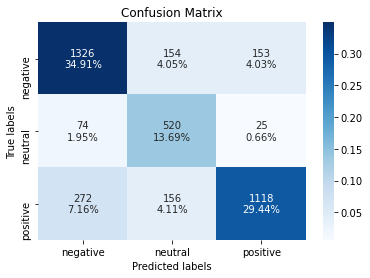

In [ ]:
X_test_tokens = tokenizer.texts_to_sequences(X_test)

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

model = keras.models.load_model('simple_lstm.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict(X_test_pad), axis=-1)

confusion_mat = confusion_matrix(test_labels, y_pred )
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/simple_lstm_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


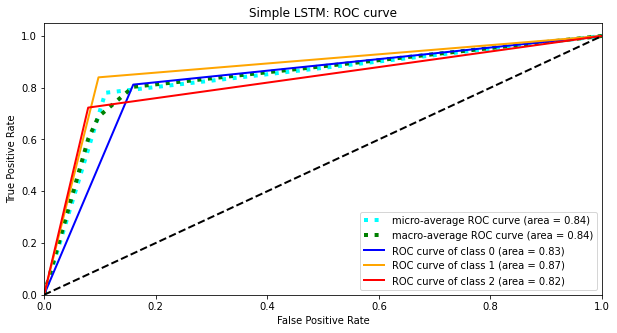

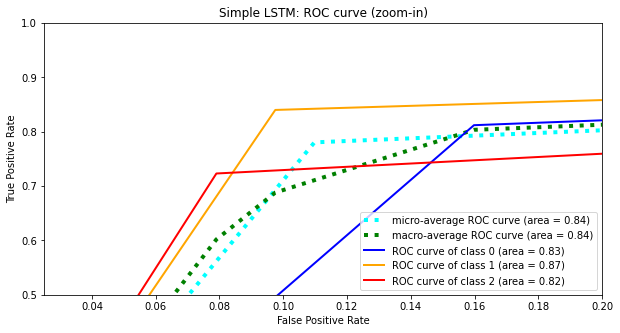

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/simple_lstm_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.2)
plt.ylim(0.5, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/simple_lstm_roc_zoom.png')
plt.show()

#GloVe/FastText+LSTM

20857
Found 1193514 word vectors.
Building model...
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
GloVe_pretrained_embeddings  (None, 117, 200)          4171400   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 117, 200)          0         
_________________________________________________________________
lstm (LSTM)                  (None, 117, 80)           89920     
_________________________________________________________________
dropout (Dropout)            (None, 117, 80)           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 117, 40)           19360     
_________________________________________________________________
dropout_1 (Dropout)          (None, 117, 40)           0         
_________________________________________________________________
lstm

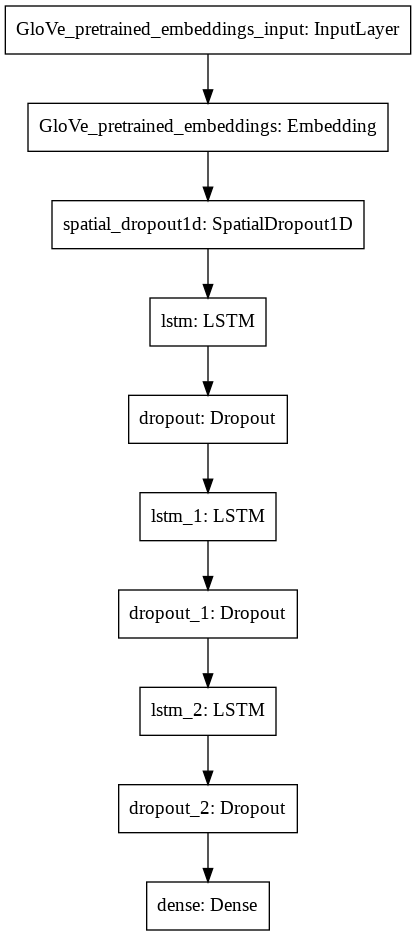

Train...
{0: 0.8909598649175218, 1: 1.778685336444963, 2: 0.7602238723262773}
Epoch 1/100
515/515 [==============================] - 21s 22ms/step - loss: 1.0223 - accuracy: 0.4369 - val_loss: 0.9566 - val_accuracy: 0.4795

Epoch 00001: val_accuracy improved from -inf to 0.47947, saving model to glove_lstm.h5
Epoch 2/100
515/515 [==============================] - 10s 20ms/step - loss: 0.9551 - accuracy: 0.5003 - val_loss: 0.8698 - val_accuracy: 0.5933

Epoch 00002: val_accuracy improved from 0.47947 to 0.59329, saving model to glove_lstm.h5
Epoch 3/100
515/515 [==============================] - 10s 20ms/step - loss: 0.8983 - accuracy: 0.5962 - val_loss: 0.9690 - val_accuracy: 0.5232

Epoch 00003: val_accuracy did not improve from 0.59329
Epoch 4/100
515/515 [==============================] - 11s 21ms/step - loss: 0.8969 - accuracy: 0.6018 - val_loss: 0.8336 - val_accuracy: 0.6488

Epoch 00004: val_accuracy improved from 0.59329 to 0.64881, saving model to glove_lstm.h5
Epoch 5/100
515/

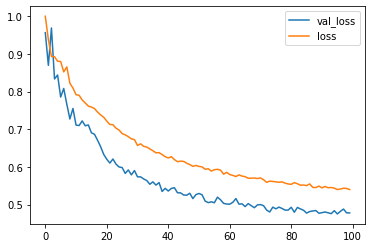

In [ ]:
#2
#LSTM with GloVe or FastText embedding

#Train-validation data split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, random_state=101)

depth= 3
y_one= tf.one_hot(y, depth)
y_train= tf.one_hot(y_train, depth)
y_val= tf.one_hot(y_val, depth)


tokenizer = Tokenizer(oov_token = True)
tokenizer.fit_on_texts(X)

#pad_sequences
columns = [train['Preprocessed_sentences']]

text = pd.concat(columns)
max_length = max([len(s.split()) for s in text])

#define word index
word_index = tokenizer.word_index

#define vocabulary size
vocab_size = len(tokenizer.word_index) + 1
print(vocab_size)


X_train_tokens = tokenizer.texts_to_sequences(X_train)

X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_val_tokens = tokenizer.texts_to_sequences(X_val)

X_val_pad = pad_sequences(X_val_tokens, 
                maxlen= max_length, padding= 'post')

embeddings_index = {}

#GloVe

f = open(os.path.join('/content/drive/My Drive/thesis_sotiria/glove.twitter.27B.200d.txt'),
         encoding="utf8")

#FastText

#f = open(os.path.join('/content/drive/My Drive/thesis_sotiria/wiki-news-300d-1M.vec'), encoding="utf8")
for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))

#Build Model

embedding_dim = 200
embedding_matrix = np.zeros((len(word_index) + 1, embedding_dim))
for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # words not found in embedding index will be all-zeros.
        embedding_matrix[i] = embedding_vector
        
embedding_layer = Embedding(len(word_index) + 1,
                            embedding_dim,
                            weights=[embedding_matrix],
                            input_length=max_length,
                            trainable=False, name="GloVe_pretrained_embeddings")

print('Building model...')
K.clear_session()
model = Sequential()
model.add(embedding_layer)
model.add(SpatialDropout1D(0.25))
model.add(LSTM(80, dropout=0.5, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(40, dropout=0.5, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(20, dropout=0.5))
model.add(Dropout(0.2))
model.add(Dense(3, activation='softmax'))
#opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='categorical_crossentropy',optimizer='adam',
                           metrics=['accuracy'])
print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/glove_lstm.png"))

#Training Model

print('Train...')
y_train_labels = np.argmax(y_one, axis =1)
class_weights = class_weight.compute_class_weight('balanced', 
                                                  np.unique(y_train_labels), y_train_labels)
class_weight_dict = dict(enumerate(class_weights))
print(class_weight_dict)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'glove_lstm.h5', monitor='val_accuracy', save_best_only=True, verbose=2)
early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 10)
      
model.fit(X_train_pad, y_train, validation_data=(X_val_pad, y_val), 
          batch_size= 64, epochs= 100, 
          #class_weight= class_weight_dict,
          callbacks = [checkpoint, early_stop], )

#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]
plt.savefig("/content/drive/My Drive/thesis_sotiria/glove_lstm_losses.png")

#model.save('/content/drive/My Drive/thesis_sotiria/glove_lstm')


              precision    recall  f1-score   support

           0       0.80      0.83      0.82      1633
           1       0.69      0.79      0.74       619
           2       0.84      0.77      0.80      1546

    accuracy                           0.80      3798
   macro avg       0.78      0.79      0.79      3798
weighted avg       0.80      0.80      0.80      3798



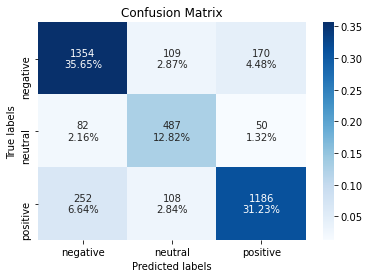

In [ ]:
X_test_tokens = tokenizer.texts_to_sequences(X_test)

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

model = keras.models.load_model('glove_lstm.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict(X_test_pad), axis=-1)
'''
confusion_mat = confusion_matrix(y_test, y_pred)
print(confusion_mat)
classification_rep = classification_report(y_test, y_pred)
print(classification_rep)
ax= plt.subplot()
sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=True, 
            fmt='.2%', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']); '''

confusion_mat = confusion_matrix(test_labels, y_pred )
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/glove_lstm_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


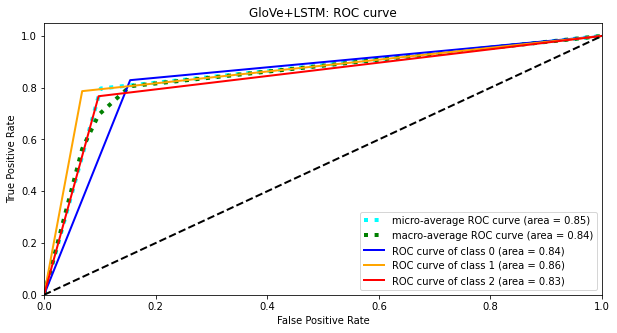

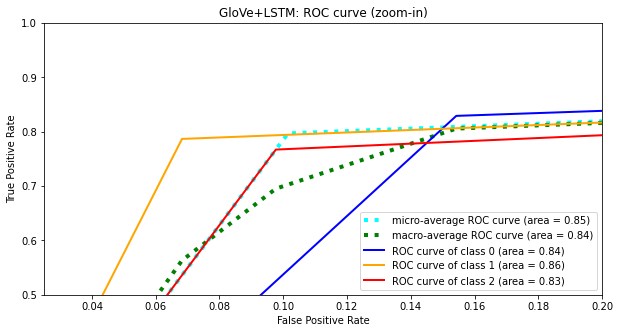

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('GloVe+LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/glove_lstm_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.2)
plt.ylim(0.5, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('GloVe+LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/glove_lstm_roc_zoom.png')
plt.show()

#BiLSTM

Building model...
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 117, 200)          4171200   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 117, 200)          0         
_________________________________________________________________
bidirectional (Bidirectional (None, 128)               135680    
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 3)                 387       
Total params: 4,307,267
Trainable params: 4,307,267
Non-trainable params: 0
_________________________________________________________________
None


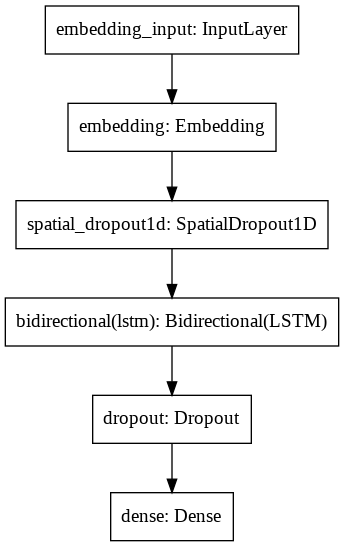

Train...
{0: 0.8909598649175218, 1: 1.778685336444963, 2: 0.7602238723262773}
Epoch 1/100
2058/2058 [==============================] - 106s 49ms/step - loss: 0.8595 - accuracy: 0.5806 - val_loss: 0.4846 - val_accuracy: 0.8313

Epoch 00001: val_accuracy improved from -inf to 0.83127, saving model to bilstm.h5
Epoch 2/100
2058/2058 [==============================] - 99s 48ms/step - loss: 0.4530 - accuracy: 0.8437 - val_loss: 0.4439 - val_accuracy: 0.8466

Epoch 00002: val_accuracy improved from 0.83127 to 0.84657, saving model to bilstm.h5
Epoch 3/100
2058/2058 [==============================] - 98s 48ms/step - loss: 0.3529 - accuracy: 0.8777 - val_loss: 0.4357 - val_accuracy: 0.8543

Epoch 00003: val_accuracy improved from 0.84657 to 0.85435, saving model to bilstm.h5
Epoch 4/100
2058/2058 [==============================] - 98s 47ms/step - loss: 0.2952 - accuracy: 0.8993 - val_loss: 0.4712 - val_accuracy: 0.8488

Epoch 00004: val_accuracy did not improve from 0.85435
Epoch 5/100
2058/20

INFO:tensorflow:Assets written to: /content/drive/My Drive/thesis_sotiria/bilstm/assets


INFO:tensorflow:Assets written to: /content/drive/My Drive/thesis_sotiria/bilstm/assets


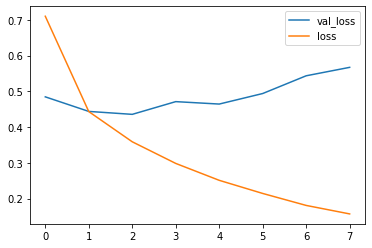

In [ ]:
#3
#BiLSTM (without pretrained embeddings)

#Train-test data split
#X_train_val, X_test, y_train_val, y_test = train_test_split(
#    X, y, test_size=0.2, random_state=101) 

#Train-validation data split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, random_state=101)

depth= 3
y_one= tf.one_hot(y, depth)
y_train= tf.one_hot(y_train, depth)
y_val= tf.one_hot(y_val, depth)

tokenizer = Tokenizer(oov_token = True)
tokenizer.fit_on_texts(X)

#pad_sequences
columns = [train['Preprocessed_sentences']]

text = pd.concat(columns)
max_length = max([len(s.split()) for s in text])

#define vocabulary size
vocab_size = len(tokenizer.word_index) + 1

X_train_tokens = tokenizer.texts_to_sequences(X_train)

X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_val_tokens = tokenizer.texts_to_sequences(X_val)

X_val_pad = pad_sequences(X_val_tokens, 
                maxlen= max_length, padding= 'post')


#Build Model

embedding_dim = 200

print('Building model...')

model = Sequential()
model.add(Embedding(vocab_size, embedding_dim, input_length = max_length))
#model.add(Embedding(embedding_layer))
model.add(SpatialDropout1D(0.25))
model.add(Bidirectional(LSTM(64, dropout=0.5)))
model.add(Dropout(0.2))
model.add(Dense(3, activation='softmax'))
model.compile(loss='categorical_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/bilstm.png"))


#Training Model

print('Train...')

y_train_labels = np.argmax(y_one, axis =1)
class_weights = class_weight.compute_class_weight('balanced', 
                                                  np.unique(y_train_labels), y_train_labels)
class_weight_dict = dict(enumerate(class_weights))
print(class_weight_dict)
early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 5)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'bilstm.h5', monitor='val_accuracy', save_best_only=True, verbose=2)  

model.fit(X_train_pad, y_train, validation_data=(X_val_pad, y_val), 
          batch_size= 16, epochs= 100, callbacks = [checkpoint, early_stop], 
          class_weight=class_weight_dict)

#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]

model.save('/content/drive/My Drive/thesis_sotiria/bilstm')


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1633
           1       0.79      0.78      0.78       619
           2       0.84      0.82      0.83      1546

    accuracy                           0.83      3798
   macro avg       0.82      0.82      0.82      3798
weighted avg       0.83      0.83      0.83      3798



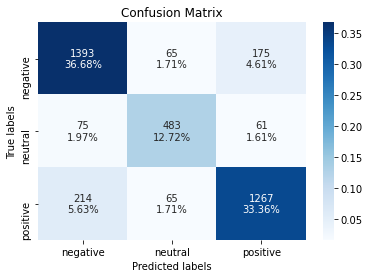

In [ ]:
X_test_tokens = tokenizer.texts_to_sequences(X_test)

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

model = keras.models.load_model('bilstm.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict(X_test_pad), axis=-1)
'''
confusion_mat = confusion_matrix(y_test, y_pred)
print(confusion_mat)
classification_rep = classification_report(y_test, y_pred)
print(classification_rep)
ax= plt.subplot()
sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=True, 
            fmt='.2%', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']); '''

confusion_mat = confusion_matrix(test_labels, y_pred )
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/bilstm_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


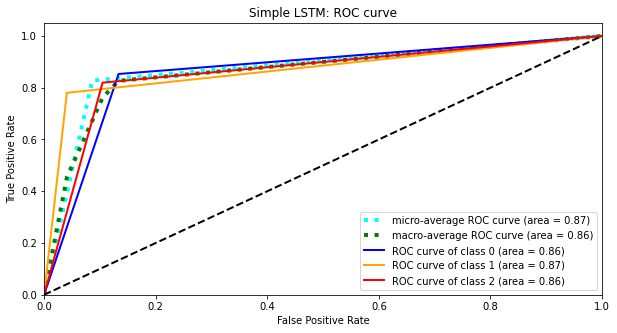

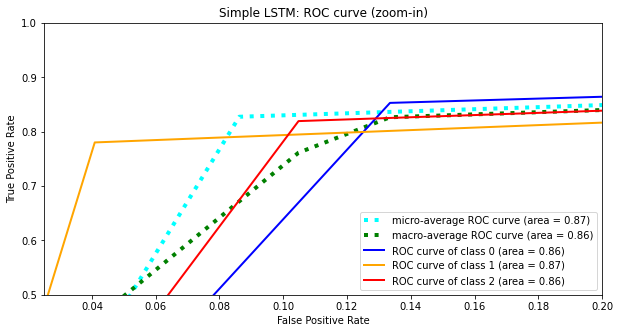

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bilstm_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.2)
plt.ylim(0.5, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/bilstm_roc_zoom.png')
plt.show()

#Word2Vec+LSTM

INFO:gensim.models.word2vec:collecting all words and their counts
INFO:gensim.models.word2vec:PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
INFO:gensim.models.word2vec:PROGRESS: at sentence #10000, processed 353108 words, keeping 11019 word types
INFO:gensim.models.word2vec:PROGRESS: at sentence #20000, processed 696172 words, keeping 15174 word types
INFO:gensim.models.word2vec:PROGRESS: at sentence #30000, processed 1029101 words, keeping 18324 word types


[['<user>', '<user>', '<user>', '<url>', 'and', '<url>', 'and', '<url>'], ['advice', 'talk', 'to', 'your', 'neighbour', 'family', 'to', 'exchange', 'phone', 'number', 'create', 'contact', 'list', 'with', 'phone', 'number', 'of', 'neighbour', 'school', 'employer', 'chemist', 'gt', 'set', 'up', 'online', 'shopping', 'account', 'if', 'pos', 'adequate', 'supply', 'of', 'regular', 'men', 'but', 'not', 'over', 'order'], ['coronavirus', 'australia', ':', 'woolworth', 'to', 'give', 'elderly', ',', 'disable', 'dedicate', 'shopping', 'hour', 'amid', 'covid', '<number>', 'outbreak', '<url>'], ['my', 'food', 'stock', 'be', 'not', 'the', 'only', 'one', 'which', 'be', 'empty', '..', 'please', ',', 'do', 'not', 'panic', ',', 'here', 'will', 'by', 'enough', 'od', 'or', 'everyone', 'if', 'you', 'do', 'not', 'take', 'more', 'than', 'you', 'need', '.', 'stay', 'calm', ',', 'stay', 'safe', '.', '<hashtag>', '<hashtag>', '<hashtag>', '<hashtag>', '<hashtag>', '<hashtag>', '<hashtag>', '<url>'], ['me', ',',

INFO:gensim.models.word2vec:PROGRESS: at sentence #40000, processed 1358780 words, keeping 21011 word types
INFO:gensim.models.word2vec:collected 21278 word types from a corpus of 1397263 raw words and 41157 sentences
INFO:gensim.models.word2vec:Loading a fresh vocabulary
INFO:gensim.models.word2vec:effective_min_count=1 retains 21278 unique words (100% of original 21278, drops 0)
INFO:gensim.models.word2vec:effective_min_count=1 leaves 1397263 word corpus (100% of original 1397263, drops 0)
INFO:gensim.models.word2vec:deleting the raw counts dictionary of 21278 items
INFO:gensim.models.word2vec:sample=0.001 downsamples 54 most-common words
INFO:gensim.models.word2vec:downsampling leaves estimated 964905 word corpus (69.1% of prior 1397263)
INFO:gensim.models.base_any2vec:estimated required memory for 21278 words and 200 dimensions: 44683800 bytes
INFO:gensim.models.word2vec:resetting layer weights
INFO:gensim.models.base_any2vec:training model with 4 workers on 21278 vocabulary and 20

Word2Vec(vocab=21278, size=200, alpha=0.025)
Found 20855 unique tokens
20856
[[   2   13 1777 ...    0    0    0]
 [  15    5  129 ...    0    0    0]
 [1274    2  212 ...    0    0    0]
 ...
 [  50 7919   71 ...    0    0    0]
 [  42  735 4809 ...    0    0    0]
 [   3   16   40 ...    0    0    0]] tf.Tensor(
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]
 ...
 [0. 1. 0.]
 [1. 0. 0.]
 [1. 0. 0.]], shape=(32925, 3), dtype=float32)
Words num %d 20856
Building model...
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
My_Word2Vec (Embedding)      (None, 117, 200)          4171200   
_________________________________________________________________
spatial_dropout1d (SpatialDr (None, 117, 200)          0         
_________________________________________________________________
bidirectional (Bidirectional (None, 128)               135680    
_____________________________________________________

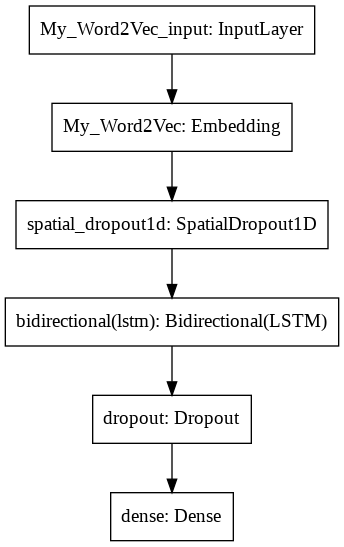

Train...
{0: 0.8932204769268333, 1: 1.7793450064850842, 2: 0.7584657912923289}
Epoch 1/100
1029/1029 [==============================] - 19s 14ms/step - loss: 1.0231 - accuracy: 0.4658 - val_loss: 0.8858 - val_accuracy: 0.5803

Epoch 00001: val_accuracy improved from -inf to 0.58030, saving model to word2vec.h5
Epoch 2/100
1029/1029 [==============================] - 14s 14ms/step - loss: 0.9034 - accuracy: 0.5718 - val_loss: 0.8360 - val_accuracy: 0.6245

Epoch 00002: val_accuracy improved from 0.58030 to 0.62451, saving model to word2vec.h5
Epoch 3/100
1029/1029 [==============================] - 14s 13ms/step - loss: 0.8710 - accuracy: 0.5953 - val_loss: 0.8695 - val_accuracy: 0.6048

Epoch 00003: val_accuracy did not improve from 0.62451
Epoch 4/100
1029/1029 [==============================] - 14s 13ms/step - loss: 0.8508 - accuracy: 0.6080 - val_loss: 0.8429 - val_accuracy: 0.6223

Epoch 00004: val_accuracy did not improve from 0.62451
Epoch 5/100
1029/1029 [=======================

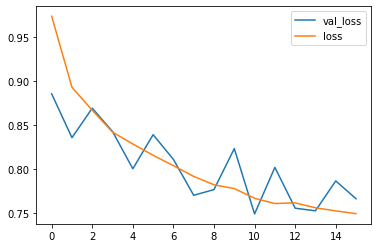

In [ ]:
#4 LSTM WITH MY OWN WORD EMBEDDING
#LSTM with implementation of Word2Vec Embedding from dataset

#Train-test data split
#X_train_val, X_test, y_train, y_test = train_test_split(
#    X, y, test_size=0.2, random_state=101) 

#Train-validation data split
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, random_state=101)

depth= 3
y_one= tf.one_hot(y, depth)
y_train= tf.one_hot(y_train, depth)
y_val= tf.one_hot(y_val, depth)

tokenizer = Tokenizer(oov_token = True)
tokenizer.fit_on_texts(X)


bigger_list=[]
for i in X:
    li = list(i.split(" "))
    bigger_list.append(li)
print (bigger_list[:10])

#Build Model

embedding_dim = 200

#train word2vec model
w2v = Word2Vec(sentences= bigger_list, 
                size= embedding_dim,
                window= 5, workers= 4, min_count=1)

print(w2v)
#vocab size
words = list(w2v.wv.vocab)

#save model
#filename = 'covid_embedding_word2vec.txt'
my_w2v_path = '/content/drive/My Drive/thesis_sotiria/covid_embedding_word2vec.txt'
w2v.wv.save_word2vec_format(my_w2v_path, binary= False)


embeddings_index = {}
f = open(os.path.join('', my_w2v_path), encoding="utf8")
for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

#pad_sequences
columns = [train['Preprocessed_sentences']]

text = pd.concat(columns)
max_length = max([len(s.split()) for s in text])

X_train_tokens = tokenizer.texts_to_sequences(X_train)
X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_val_tokens = tokenizer.texts_to_sequences(X_val)
X_val_pad = pad_sequences(X_val_tokens, 
                maxlen= max_length, padding= 'post')


word_index = tokenizer.word_index
print('Found %s unique tokens' % len(word_index))
vocab_size = len(tokenizer.word_index) + 1
print(vocab_size)
#print('Found %s unique tokens.' % len(word_index))

#review_pad = pad_sequences (sequences, maxlen= max_length)

print(X_train_pad, y_train)


embedding_matrix = np.zeros((vocab_size, embedding_dim))
for word, i in word_index.items():
    if i > vocab_size:
        continue
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # words not found in embedding index will be all-zeros.
        embedding_matrix[i] = embedding_vector
        
embedding_layer = Embedding(vocab_size,
                embedding_dim,
                embeddings_initializer = Constant(embedding_matrix),
                input_length=max_length,
                trainable=False, name="My_Word2Vec")

print('Words num %d', (len(word_index) + 1))

print('Building model...')

model = Sequential()
model.add(embedding_layer)
model.add(SpatialDropout1D(0.25))
model.add(Bidirectional(LSTM(64, dropout=0.5)))
model.add(Dropout(0.2))
model.add(Dense(3, activation='softmax'))
model.compile(loss='categorical_crossentropy',optimizer='adam', 
                           metrics=['accuracy'])
print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/word2vec.png"))

#Training Model

print('Train...')
y_train_labels = np.argmax(y_one, axis =1)
class_weights = class_weight.compute_class_weight('balanced', 
                                                  np.unique(y_train_labels), y_train_labels)
class_weight_dict = dict(enumerate(class_weights))
print(class_weight_dict)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'word2vec.h5', monitor='val_accuracy', save_best_only=True, verbose=2)

early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 5)

model.fit(X_train_pad, y_train, validation_data=(X_val_pad, y_val),
           batch_size= 32, epochs= 100, class_weight= class_weight_dict,
           callbacks = [early_stop, checkpoint])
           
#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]
plt.savefig("/content/drive/My Drive/thesis_sotiria/word2vec_losses.png")


              precision    recall  f1-score   support

           0       0.72      0.70      0.71      1633
           1       0.48      0.76      0.59       619
           2       0.77      0.60      0.67      1546

    accuracy                           0.67      3798
   macro avg       0.65      0.69      0.66      3798
weighted avg       0.70      0.67      0.68      3798



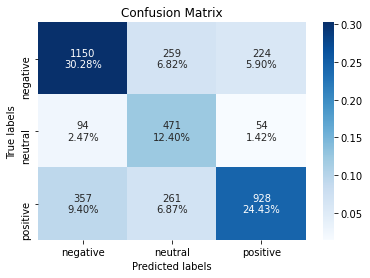

In [ ]:
X_test_tokens = tokenizer.texts_to_sequences(X_test)

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

model = keras.models.load_model('word2vec.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict(X_test_pad), axis=-1)
'''
confusion_mat = confusion_matrix(y_test, y_pred)
print(confusion_mat)
classification_rep = classification_report(y_test, y_pred)
print(classification_rep)
ax= plt.subplot()
sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=True, 
            fmt='.2%', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']); '''

confusion_mat = confusion_matrix(test_labels, y_pred )
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/word2vec_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


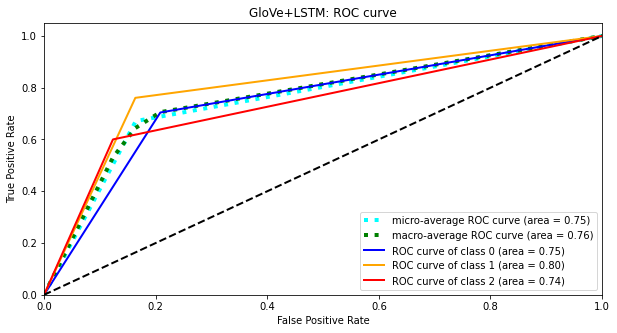

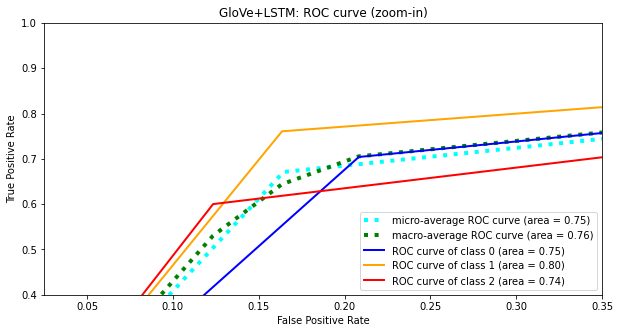

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('GloVe+LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/word2vec_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.35)
plt.ylim(0.4, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('GloVe+LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/word2vec_roc_zoom.png')
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  after removing the cwd from sys.path.


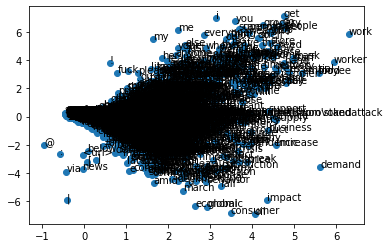

In [ ]:
from sklearn.decomposition import PCA

#Visualizing Embeddings
X = w2v[w2v.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
# create a scatter plot of the projection
plt.scatter(result[:, 0], result[:, 1])
words = list(w2v.wv.vocab)
for i, word in enumerate(words):
    plt.annotate(word, xy=(result[i, 0], result[i, 1]))
plt.show()

In [ ]:
from matplotlib import pyplot as plt
import plotly.graph_objects as go

from sklearn.decomposition import PCA

#pass the embeddings to PCA
X = w2v[w2v.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])
#add the words for the hover effect
pca_df['word'] = words
pca_df.head()

N = 1000000
fig = go.Figure(data=go.Scattergl(
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    text=pca_df['word'],
    textposition="bottom center"
))
fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



#Text and Numerical Data combined

tf.Tensor(
[[0. 1. 0.]
 [0. 0. 1.]
 [0. 0. 1.]
 ...
 [0. 0. 1.]
 [0. 1. 0.]
 [1. 0. 0.]], shape=(41157, 3), dtype=float32)
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Text_data (InputLayer)          [(None, 117)]        0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 117, 200)     4171200     Text_data[0][0]                  
__________________________________________________________________________________________________
spatial_dropout1d (SpatialDropo (None, 117, 200)     0           embedding[0][0]                  
__________________________________________________________________________________________________
bidirectional (Bidirectional)   (None, 240)          308160      spati

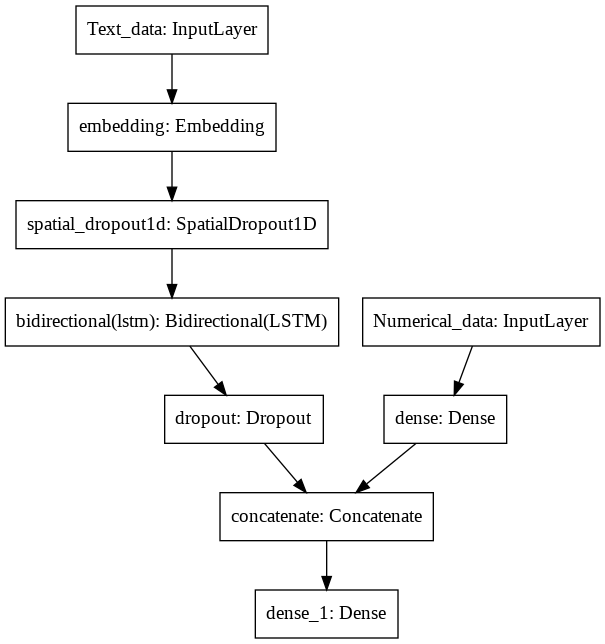

Train...
Epoch 1/100
1029/1029 [==============================] - 70s 63ms/step - loss: 0.8454 - accuracy: 0.5885 - val_loss: 0.4898 - val_accuracy: 0.8219

Epoch 00001: val_accuracy improved from -inf to 0.82191, saving model to text_numerical.h5
Epoch 2/100
1029/1029 [==============================] - 63s 62ms/step - loss: 0.4395 - accuracy: 0.8487 - val_loss: 0.4557 - val_accuracy: 0.8423

Epoch 00002: val_accuracy improved from 0.82191 to 0.84232, saving model to text_numerical.h5
Epoch 3/100
1029/1029 [==============================] - 63s 61ms/step - loss: 0.3354 - accuracy: 0.8854 - val_loss: 0.4290 - val_accuracy: 0.8445

Epoch 00003: val_accuracy improved from 0.84232 to 0.84451, saving model to text_numerical.h5
Epoch 4/100
1029/1029 [==============================] - 64s 62ms/step - loss: 0.2729 - accuracy: 0.9056 - val_loss: 0.4588 - val_accuracy: 0.8417

Epoch 00004: val_accuracy did not improve from 0.84451
Epoch 5/100
1029/1029 [==============================] - 64s 62ms

'#predict\n\ny_pred = np.argmax(model.predict([X1_test_pad, scaled_X2_test]), axis=1)\nprint(y_pred)\n\nconfusion_mat = confusion_matrix(y_test, y_pred)\nprint(confusion_mat)\nclassification_rep = classification_report(y_test, y_pred)\nprint(classification_rep)'

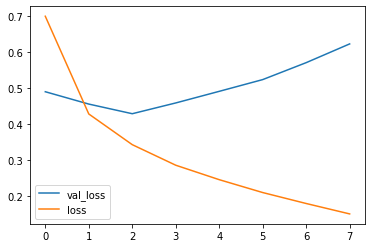

In [ ]:
#Text and Numerical Data combined

text = train.loc[:, 'Preprocessed_sentences'].values
X_mixed_train = train.loc[:, {'Preprocessed_sentences',
                  'count_words', 'count_unique_words',
                  'count_letters', 'count_stopwords',
                  'mean_word_len', 'count_words_upper',
                  'count_words_title', 'count_mentions',
                  'count_hashtags', 'count_urls', 
                  'count_excl_quest_marks', 'Nouns', 'Others',
                  'Verbs', 'Adjectives', 'Adverbs'}]

#y = train.loc[:, 'Sentiment']


#Train-test data split
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101) 

#print(X_train.shape, X_test.shape, y_train.shape)

#Divide train dataset between text and numerical data
X1_train = X_mixed_train.loc[:, 'Preprocessed_sentences'].values    #text data - train
X2_train = X_mixed_train.loc[:, [
                  'count_words', 'count_unique_words',
                  'count_letters', 'count_stopwords',
                  'mean_word_len', 'count_words_upper',
                  'count_words_title', 'count_mentions',
                  'count_hashtags', 'count_urls', 
                  'count_excl_quest_marks', 'Nouns', 'Others',
                  'Verbs', 'Adjectives', 'Adverbs']].values    #numerical data - train



X1_train = X1_train.astype(str)

#y_train = y_train.values
#y_test = y_test.values

depth= 3
y_train_ohe= tf.one_hot(y, depth)
print(y_train_ohe)

#Scale numerical data between [0, 1]
scaler_object = MinMaxScaler()
scaler_object.fit(X2_train)
scaled_X2_train = scaler_object.transform(X2_train)  #scaled numerical train data


#Tokenizer
tokenizer = Tokenizer(oov_token=True)
tokenizer.fit_on_texts(X1_train)

#pad_sequences
max_length = max([len(s.split()) for s in train['Preprocessed_sentences']])

#define vocabulary size
vocab_size = len(tokenizer.word_index) + 1

X1_train_tokens = tokenizer.texts_to_sequences(X1_train)

X1_train_pad = pad_sequences(X1_train_tokens, 
                maxlen= max_length, padding= 'post')



#define word index
word_index = tokenizer.word_index

numerical_columns = len(list(X_mixed_train))-1

#####GloVe#####
'''
embeddings_index = {}

#GloVe
path2= '/content/drive/My Drive/thesis_sotiria/glove.twitter.27B.200d.txt'
f = open(os.path.join(path2), encoding="utf8")

#FastText
#f = open(os.path.join('wiki-news-300d-1M.vec'), encoding="utf8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

print('Found %s word vectors.' % len(embeddings_index))

#Build Model

embedding_dim = 200
embedding_matrix = np.zeros((len(word_index) + 1, embedding_dim))
for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # words not found in embedding index will be all-zeros.
        embedding_matrix[i] = embedding_vector
        
embedding_layer = Embedding(len(word_index) + 1,
                            embedding_dim,
                            weights=[embedding_matrix],
                            input_length=max_length,
                            trainable=False)'''
#####GloVe####

# Build the model with Functional API

embedding_dim = 200

#text data input
text_input = Input(shape=(max_length), name= 'Text_data') 
#emb = embedding_layer (text_input)
emb = Embedding(vocab_size, embedding_dim, input_length = max_length) (text_input)
spat_drop = SpatialDropout1D(0.25)(emb) 
lstm1 = Bidirectional(LSTM(120, dropout=0.5))(spat_drop) 
#lstm1 = LSTM(120, dropout=0.4))(spat_drop)
drop1 = Dropout(0.2)(lstm1)
#lstm2 = LSTM(60, dropout=0.4, return_sequences= True)(drop1) 
#drop2 = Dropout(0.2)(lstm2)
#lstm3 = LSTM(30, dropout=0.4)(drop2) 
#drop3 = Dropout(0.2)(lstm3)
#out1 = Dense(20, activation='tanh')(lstm1)

#numerical data input
metadata = Input(shape=(numerical_columns), name= 'Numerical_data')
#hidden = Dense(20, activation='relu')(metadata)
out2 = Dense(10, activation='relu')(metadata)

#Concatenation of two outputs
concat = concatenate([drop1, out2])  # merge output of text and numerical data

output = Dense(3, activation='softmax')(concat) 
model = Model(inputs=[text_input, metadata], outputs=output)

# Compile the model 
model.compile(loss='categorical_crossentropy',optimizer='Adam', 
                           metrics=['accuracy'])

print(model.summary())

# plot graph
display(plot_model(model, to_file="/content/drive/My Drive/thesis_sotiria/text_numerical.png"))

#Training Model

print('Train...')
y_train_labels = np.argmax(y_train_ohe, axis =1)
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    'text_numerical.h5', monitor='val_accuracy', save_best_only=True, verbose=2)
early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 1,  patience = 5)

model.fit(x= [X1_train_pad, scaled_X2_train], 
          y= y_train_ohe, validation_split=0.2, batch_size= 32,
          epochs= 100, callbacks = [early_stop, checkpoint])

#Printing losses
model_loss = pd.DataFrame(model.history.history)
model_loss[['val_loss',"loss"]].plot()
[['val_loss',"loss"]]
plt.savefig("/content/drive/My Drive/thesis_sotiria/text_numerical_losses.png")

'''#predict

y_pred = np.argmax(model.predict([X1_test_pad, scaled_X2_test]), axis=1)
print(y_pred)

confusion_mat = confusion_matrix(y_test, y_pred)
print(confusion_mat)
classification_rep = classification_report(y_test, y_pred)
print(classification_rep)'''

              precision    recall  f1-score   support

           0       0.82      0.87      0.84      1633
           1       0.83      0.74      0.78       619
           2       0.84      0.83      0.83      1546

    accuracy                           0.83      3798
   macro avg       0.83      0.81      0.82      3798
weighted avg       0.83      0.83      0.83      3798



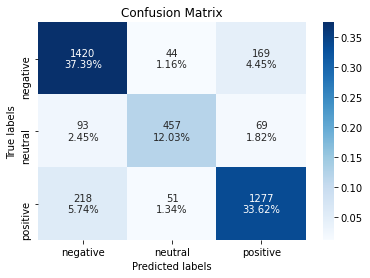

In [ ]:
X_mixed_test = test.loc[:, {'Preprocessed_sentences',
                  'count_words', 'count_unique_words',
                  'count_letters', 'count_stopwords',
                  'mean_word_len', 'count_words_upper',
                  'count_words_title', 'count_mentions',
                  'count_hashtags', 'count_urls', 
                  'count_excl_quest_marks', 'Nouns', 'Others',
                  'Verbs', 'Adjectives', 'Adverbs'}]

#Divide test dataset between text and numerical data
X1_test = X_mixed_test.loc[:, 'Preprocessed_sentences'].values  #text data - test
X2_test = X_mixed_test.loc[:, [
                  'count_words', 'count_unique_words',
                  'count_letters', 'count_stopwords',
                  'mean_word_len', 'count_words_upper',
                  'count_words_title', 'count_mentions',
                  'count_hashtags', 'count_urls', 
                  'count_excl_quest_marks', 'Nouns', 'Others',
                  'Verbs', 'Adjectives', 'Adverbs']].values  #numerical data - test

X1_test_tokens = tokenizer.texts_to_sequences(X1_test)

X1_test_pad = pad_sequences(X1_test_tokens, 
                maxlen= max_length, padding= 'post')
scaled_X2_test = scaler_object.transform(X2_test)   #scaled numerical test data

model = keras.models.load_model('text_numerical.h5')
test_labels = test['Sentiment'].to_numpy()

#predict

y_pred = np.argmax(model.predict([X1_test_pad, scaled_X2_test]), axis=1)

confusion_mat = confusion_matrix(test_labels, y_pred )
classification_rep = classification_report(test_labels, y_pred)
print(classification_rep)
ax= plt.subplot()

group_counts = ['{0:0.0f}'.format(value) for value in
                confusion_mat.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     confusion_mat.flatten()/np.sum(confusion_mat)]
labels = [f'{v1}\n{v2}' for v1, v2 in
          zip(group_counts,group_percentages)]
labels = np.asarray(labels).reshape(3,3)

sns.heatmap(confusion_mat/np.sum(confusion_mat), annot=labels, 
            fmt='', cmap='Blues')
# labels, title and ticks
ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['negative', 'neutral', 'positive']); 
ax.yaxis.set_ticklabels(['negative', 'neutral', 'positive']);
ax.figure.savefig(
    '/content/drive/My Drive/thesis_sotiria/text_numerical_conf_mat.png')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


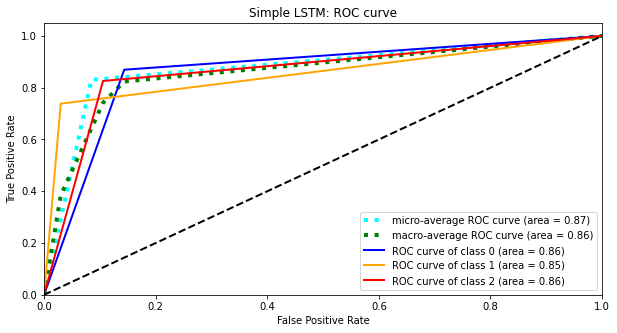

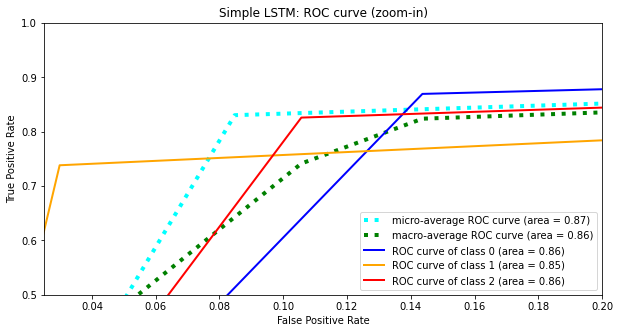

In [ ]:
# 3 classes to classify
n_classes = 3
test_labels = label_binarize(test_labels, classes=[0, 1, 2])
test_pred = label_binarize(y_pred , classes=[0, 1, 2])

# Plot linewidth.
lw = 2

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(test_labels[:, i], test_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(test_labels.ravel(), test_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and ROC area

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1, figsize=(10,5))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/text_numerical_roc.png')
plt.show()


# Zoom in view of the upper left corner.
plt.figure(2, figsize=(10,5))
plt.xlim(0.025, 0.2)
plt.ylim(0.5, 1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='aqua', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='green', linestyle=':', linewidth=4)

colors = cycle(["blue", "orange", "red"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Simple LSTM: ROC curve (zoom-in)')
plt.legend(loc="lower right")
plt.savefig('/content/drive/My Drive/thesis_sotiria/text_numerical_roc_zoom.png')
plt.show()

#GridSearch

In [ ]:
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV

#Grid search

X = train.loc[:, 'Preprocessed_sentences'].values
y = train.loc[:, 'Sentiment'].values

#Train-test data split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2) 

depth= 3
#y_train= tensorflow.one_hot(y_train, depth)

tokenizer = Tokenizer()
tokenizer.fit_on_texts(X_train)

#pad_sequences
max_length = max([len(s.split()) for s in X])

#define vocabulary size
vocab_size = len(tokenizer.word_index) + 1

X_train_tokens = tokenizer.texts_to_sequences(X_train)

X_train_pad = pad_sequences(X_train_tokens, 
                maxlen= max_length, padding= 'post')

X_test_tokens = tokenizer.texts_to_sequences(X_test)

X_test_pad = pad_sequences(X_test_tokens, 
                maxlen= max_length, padding= 'post')

print(X_train_pad, y_train)

#Build Model
embedding_dim = 200
#modelo me tuning parametrwn

def create_model(neurons =60, dropout_rate=0.2):
	# cleanup
  K.clear_session()

  model = Sequential()
  model.add(Embedding(vocab_size, embedding_dim, input_length = max_length))
  model.add(SpatialDropout1D(0.25))
  model.add(LSTM(neurons, dropout=dropout_rate, return_sequences= True))
  model.add(BatchNormalization())
  model.add(LSTM(90, dropout=dropout_rate, return_sequences= True))
  model.add(BatchNormalization())
  model.add(LSTM(40, dropout=dropout_rate))
  model.add(BatchNormalization())
  model.add(Dense(10, activation='tanh'))
  model.add(Dense(3, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam',
	               metrics=['accuracy'])
  return model

early_stop = EarlyStopping(monitor='val_loss', mode= 'min', 
                          verbose= 2,  patience = 5) 

model = KerasClassifier(build_fn= create_model, validation_split= 0.2, 
                        epochs= 50, batch_size= 32, verbose= 2)
dropout_rate = [0.2, 0.5]
#embedding_dim = [100, 200]
SpatialDropout = [0.25, 0.5]
neurons = [160, 180]
Dropout_rate = [0.2, 0.5]
recurrent_dropout = [0.2, 0.5]

# define the grid search parameters
param_grid = dict( neurons= neurons, dropout_rate=dropout_rate)
grid = GridSearchCV(estimator= model, param_grid= param_grid, cv= 3,
                    scoring='accuracy')

grid_result = grid.fit(X_train_pad, y_train, callbacks = [early_stop])

#model.fit(X_train_pad, y_train, validation_split=0.2, batch_size= 32, epochs= 100)


print('Best Score: %s' % grid_result.best_score_)
print('Best Hyperparameters: %s' % grid_result.best_params_)
